<a href="https://colab.research.google.com/github/paolala24/aprendizaje_maquinas/blob/main/Talleres/super_mario_bros.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!pip install gym==0.17.2
#!pip install gym-super-mario-bros==7.3.0
#!pip install nes-py==8.1.8
#!pip install tf-agents==0.5.0
#!pip install tensorflow==2.2.0

#librerias necesarias
!sudo apt-get update
!sudo apt-get install -y xvfb ffmpeg freeglut3-dev
!pip install 'imageio==2.4.0'
!pip install pyvirtualdisplay
!pip install tf-agents[reverb]
!pip install pyglet
!pip install swig
!pip install gym[atari,box2d,accept-rom-license]  #install gym and virtual display
!pip install gym-super-mario-bros

Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:3 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:4 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Hit:5 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:6 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:7 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Hit:8 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:9 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Reading package lists... Done
Building dependency tree... Done
Reading

In [ ]:
from __future__ import absolute_import, division, print_function

import base64
import imageio
import IPython
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import pyvirtualdisplay
import reverb

import tensorflow as tf

from tf_agents.environments import suite_gym, tf_py_environment
from tf_agents.environments.wrappers import ActionRepeat
from tf_agents.networks.q_network import QNetwork
from tf_agents.agents.dqn.dqn_agent import DqnAgent
from tf_agents.utils import common
from tf_agents.replay_buffers import TFUniformReplayBuffer
from tf_agents.trajectories import trajectory
from tf_agents.policies import random_tf_policy
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver


from tf_agents.environments import gym_wrapper
from tf_agents.environments import tf_py_environment

import gym
from nes_py.wrappers import JoypadSpace
import gym_super_mario_bros
from gym_super_mario_bros.actions import SIMPLE_MOVEMENT

# To get smooth animations
import matplotlib.animation as animation
matplotlib.rc('animation', html='jshtml')

/usr/local/lib/python3.11/dist-packages/gym/envs/registration.py:505: UserWarning: WARN: The environment SuperMarioBros-v1 is out of date. You should consider upgrading to version `v3` with the environment ID `SuperMarioBros-v3`.
  logger.warn(


['NOOP', 'right', 'right A', 'right B', 'right A B', 'A', 'left']


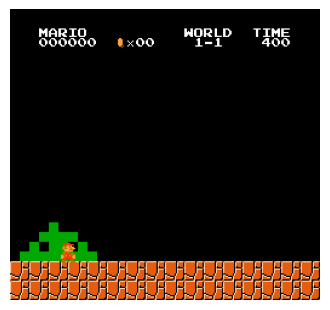

In [ ]:
env = gym_super_mario_bros.make('SuperMarioBros-v1')
env = JoypadSpace(env, SIMPLE_MOVEMENT)
print(env.get_action_meanings())
state = env.reset()
env.step(env._action_space.sample())
img = env.render(mode="rgb_array")
plt.figure(figsize=(4, 6))
plt.imshow(img)
plt.axis("off")
plt.show()

In [ ]:
# Crear el entorno
def create_environment():
    import gym
    from nes_py.wrappers import JoypadSpace
    import gym_super_mario_bros
    from gym_super_mario_bros.actions import SIMPLE_MOVEMENT
    env = gym_super_mario_bros.make('SuperMarioBros-v1')
    env = JoypadSpace(env, SIMPLE_MOVEMENT)
    env = gym_wrapper.GymWrapper(env)
    return env

eval_py_env = create_environment()
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

# Crear una política aleatoria
random_policy = random_tf_policy.RandomTFPolicy(
    time_step_spec=eval_env.time_step_spec(),
    action_spec=eval_env.action_spec()
)

# Definir la función para ejecutar y visualizar la política aleatoria
def run_and_visualize_random(policy, env, max_steps=1000):
    frames = []
    time_step = env.reset()
    policy_state = policy.get_initial_state(env.batch_size)
    step_count = 0
    while not time_step.is_last() and step_count < max_steps:
        action_step = policy.action(time_step, policy_state)
        policy_state = action_step.state
        time_step = env.step(action_step.action)
        # Captura la observación actual
        frame = time_step.observation.numpy()[0]
        # Transforma la observación para visualizar
        frame = frame.astype(np.uint8)
        frames.append(frame)
        step_count += 1
    return frames

# Definir las funciones de animación
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

# Ejecutar la política aleatoria y visualizar el juego
frames = run_and_visualize_random(random_policy, eval_env, max_steps=1000)
anim = plot_animation(frames)

from IPython.display import HTML
HTML(anim.to_jshtml())

In [ ]:
# Create and wrap the environment
def create_environment():
    # Load the Super Mario Bros environment
    env = gym_super_mario_bros.make('SuperMarioBros-v1')
    # Simplify the action space
    env = JoypadSpace(env, SIMPLE_MOVEMENT)
    # Apply preprocessing wrappers
    #env = gym.wrappers.GrayScaleObservation(env, keep_dim=True)
    #env = gym.wrappers.ResizeObservation(env, 84)
    #env = gym.wrappers.FrameStack(env, 4)
    env = gym_wrapper.GymWrapper(env)
    return env

In [ ]:
# Instantiate training and evaluation environments
train_py_env = create_environment()
eval_py_env = create_environment()

/usr/local/lib/python3.11/dist-packages/gym/envs/registration.py:505: UserWarning: WARN: The environment SuperMarioBros-v1 is out of date. You should consider upgrading to version `v3` with the environment ID `SuperMarioBros-v3`.
  logger.warn(


In [ ]:
# Convert to TensorFlow Agents environments
train_env = tf_py_environment.TFPyEnvironment(train_py_env)
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

In [ ]:
# Define the Q-network
preprocessing_layer = tf.keras.layers.Lambda(lambda x: tf.cast(x, np.float32) / 255.)
conv_layer_params = [
    (128, (8, 8), 4),
    (256, (4, 4), 2),
    (128, (3, 3), 1),
]


'''
conv_layer_params = [
    (32, (8, 8), 4),
    (64, (4, 4), 2),
    (64, (3, 3), 1),
]
'''
fc_layer_params = [1024, 512]

q_net = QNetwork(
    input_tensor_spec=train_env.observation_spec(),
    action_spec=train_env.action_spec(),
    preprocessing_layers=preprocessing_layer,
    conv_layer_params=conv_layer_params,
    fc_layer_params=fc_layer_params
)

# Create the DQN agent
optimizer = tf.compat.v1.train.RMSPropOptimizer(
    learning_rate=4e-4, # 2.5e-4,
    decay=0.85, #0.95,
    momentum=0.2, #0.1,
    epsilon=0.03, #0.05,
    centered=True
)
train_step_counter = tf.Variable(0)

agent = DqnAgent(
    time_step_spec=train_env.time_step_spec(),
    action_spec=train_env.action_spec(),
    q_network=q_net,
    optimizer=optimizer,
    td_errors_loss_fn=common.element_wise_squared_loss,
    train_step_counter=train_step_counter,
    gamma=0.85, #0.99,
    epsilon_greedy=0.05,
    #epsilon_greedy = tf.keras.optimizers.schedules.PolynomialDecay(
    #initial_learning_rate=1.0,
    #decay_steps=50000,
    #end_learning_rate=0.01),
    target_update_period=300
)


In [ ]:
agent.initialize()

# Create the replay buffer
replay_buffer = TFUniformReplayBuffer(
    data_spec=agent.collect_data_spec,
    batch_size=train_env.batch_size,
    max_length=10000
)

In [ ]:
# Function to collect experience
def collect_step(environment, policy, buffer):
    time_step = environment.current_time_step()
    action_step = policy.action(time_step)
    next_time_step = environment.step(action_step.action)
    traj = trajectory.from_transition(time_step, action_step, next_time_step)
    buffer.add_batch(traj)

# Collect initial data with a random policy
random_policy = random_tf_policy.RandomTFPolicy(train_env.time_step_spec(), train_env.action_spec())
initial_collect_steps = 10000
for _ in range(initial_collect_steps):
    collect_step(train_env, random_policy, replay_buffer)

# Prepare the dataset
dataset = replay_buffer.as_dataset(
    num_parallel_calls=3,
    sample_batch_size=32,
    num_steps=2
).prefetch(3)
iterator = iter(dataset)

Instructions for updating:
Use `as_dataset(..., single_deterministic_pass=False) instead.


In [ ]:
# Training the agent
num_iterations = 200000  # Adjust this value based on Kaggle's computational limits
collect_steps_per_iteration = 1
log_interval = 1000

for iteration in range(num_iterations):
    # Collect experience
    for _ in range(collect_steps_per_iteration):
        collect_step(train_env, agent.collect_policy, replay_buffer)
    # Sample a batch of data and train the agent
    experience, _ = next(iterator)
    train_loss = agent.train(experience).loss
    if iteration % log_interval == 0:
        print(f'Iteration: {iteration}, Loss: {train_loss}')



Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.foldr(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.foldr(fn, elems))


Iteration: 0, Loss: 0.8688773512840271
Iteration: 1000, Loss: 0.13204266130924225


In [ ]:
# Evaluate the agent's performance
log_interval = 1000
num_eval_episodes = 5
for episode in range(num_eval_episodes):
    time_step = eval_env.reset()
    episode_reward = 0
    i = 0
    while not time_step.is_last():
        action_step = agent.policy.action(time_step)
        time_step = eval_env.step(action_step.action)
        episode_reward += time_step.reward
        i+=1

        if i % log_interval == 0:
            print(f'Episode {episode + 1}: Ite.: {i} :episode_reward : {episode_reward.numpy()[0]}')
    #print(f'Episode {episode + 1}: Reward = {episode_reward.numpy()[0]}')

In [ ]:
# Crear el entorno
def create_environment():
    import gym
    from nes_py.wrappers import JoypadSpace
    import gym_super_mario_bros
    from gym_super_mario_bros.actions import SIMPLE_MOVEMENT
    env = gym_super_mario_bros.make('SuperMarioBros-v1')
    env = JoypadSpace(env, SIMPLE_MOVEMENT)
    env = gym_wrapper.GymWrapper(env)
    return env

eval_py_env = create_environment()
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

# Definir la función para ejecutar y visualizar la política aleatoria
def run_and_visualize_random(agent, env, max_steps=1000):
    frames = []
    time_step = env.reset()
    policy_state = agent.policy.get_initial_state(env.batch_size)
    step_count = 0
    while not time_step.is_last() and step_count < max_steps:
        action_step = agent.policy.action(time_step, policy_state)
        policy_state = action_step.state
        time_step = env.step(action_step.action)
        # Captura la observación actual
        frame = time_step.observation.numpy()[0]
        # Transforma la observación para visualizar
        frame = frame.astype(np.uint8)
        frames.append(frame)
        step_count += 1
    return frames

# Definir las funciones de animación
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch

def plot_animation(frames, repeat=False, interval=50):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

# Ejecutar la política aleatoria y visualizar el juego
frames = run_and_visualize_random(agent, eval_env, max_steps=10000)
anim = plot_animation(frames)

from IPython.display import HTML
HTML(anim.to_jshtml())

In [ ]:
# Guardar la animación como un video MP4
def save_animation(anim, filename='mario_run.mp4', fps=25):
    anim.save(filename, writer='ffmpeg', fps=fps)
    print(f'Animación guardada como {filename}')

save_animation(anim, 'mario_run.mp4')

from IPython.display import FileLink
FileLink('mario_run.mp4')